## Unsupervised Learning

<p><img src="https://cdn.gritglobal.io/uploads/too-broad-customer-segmentation.jpg" width="1000"/></p>

## Segmentacion de Clientes
<p>En esté capitulo nos vamos a enfocar en entender y trabajar un caso de uso para segmentación de clientes, pero antes de eso aquí una pequeña lista de más aplicaciones que se pueden trabajar con los datos recopliados de mis clientes

- Estadística Descriptiva
- Segmentación de Clientes
- Predicción de Abandono
- Valor del Cliente a traves del tiempo (CTLV)

La segmentación la vamos a hacer con base en una metodolgía llamada <b>RFM</b>

</p>

In [234]:
# Importa Pandas, Numpy, Seaborn y Matplotlib
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


# Importa el archivo "Online Retail.csv"
cliente_segment = pd.read_csv('C:/Users/Isaac/Desktop/IHD/EBAC DT/CIENCIA DE DATOS/M30 DS/M30 Online Retail.csv')
cliente_segment

,INVOICE_NO,STOCK_CODE,DESCRIPTION,QUANTITY,INVOICE_DATE,UNIT_PRICE,CUSTOMER_ID,REGION
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,01/12/2019 08:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,01/12/2019 08:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,01/12/2019 08:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,01/12/2019 08:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,01/12/2019 08:26,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,09/12/2020 12:50,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,09/12/2020 12:50,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,09/12/2020 12:50,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,09/12/2020 12:50,4.15,12680.0,France


 67%|######6   | 2/3 [00:00<?, ?it/s]

100%|##########| 2/2 [00:00<?, ?it/s]

100%|##########| 2/2 [00:00<?, ?it/s]

  0%|          | 0/1315 [00:00<?, ?it/s]

C:\Users\Isaac\anaconda3\Lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\Isaac\anaconda3\Lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\Isaac\anaconda3\Lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\Isaac\anaconda3\Lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append metho

DataPrep Report
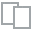
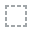
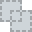
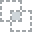
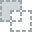
...
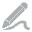
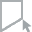
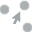
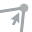
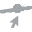

In [8]:
# Análisis Exploratorio
from dataprep.eda import create_report
create_report(cliente_segment)

## Recency
<p>Indicador que nos dice que tan reciente es la compra de un cliente</p>

In [260]:
# Obtener los clientes unicos
customer = cliente_segment['CUSTOMER_ID'].unique()
customer

array([17850., 13047., 12583., ..., 13298., 14569., 12713.])

In [261]:
cliente_segment['INVOICE_DATE'] = pd.to_datetime(cliente_segment['INVOICE_DATE'])
# Obtener la última fecha de compra por cliente
max_purchase = cliente_segment['INVOICE_DATE'].max()
max_purchase

Timestamp('2020-12-10 17:19:00')

In [262]:
# Vamos a calcular nuestra metrica de Recency, esto lo haremos restando los días de la última fecha de compra a cada observacón
recency = cliente_segment.groupby('CUSTOMER_ID')['INVOICE_DATE'].max().reset_index()
recency['RECENCY'] = (max_purchase - recency['INVOICE_DATE']).dt.days
recency.head()

,CUSTOMER_ID,INVOICE_DATE,RECENCY
0,12346.0,2020-01-18 10:17:00,327
1,12347.0,2020-10-31 12:25:00,40
2,12348.0,2020-09-25 13:13:00,76
3,12349.0,2020-11-21 09:51:00,19
4,12350.0,2020-02-02 16:01:00,312


In [263]:
customer = pd.DataFrame(customer, columns=['CUSTOMER_ID'])
# Unir el DataFrame de clientes únicos con el que acabamos de crear de la última fecha de compra
customer = pd.merge(customer, recency, on = 'CUSTOMER_ID', how = 'left')
customer.head()

,CUSTOMER_ID,INVOICE_DATE,RECENCY
0,17850.0,2020-10-02 14:38:00,69.0
1,13047.0,2020-10-24 14:02:00,47.0
2,12583.0,2020-12-10 14:46:00,0.0
3,13748.0,2020-07-04 10:13:00,159.0
4,15100.0,2020-10-01 10:35:00,70.0


In [264]:
customer.columns

Index(['CUSTOMER_ID', 'INVOICE_DATE', 'RECENCY'], dtype='object')

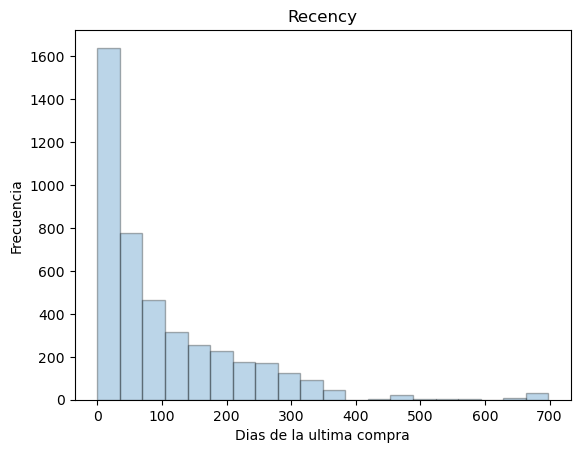

In [265]:
# Grafica un histograma de Recency
plt.figure()
plt.hist(customer['RECENCY'], bins=20, edgecolor = 'black', alpha = 0.3)
plt.title('Recency')
plt.xlabel('Dias de la ultima compra')
plt.ylabel('Frecuencia')
plt.show()

In [266]:
# Imprime la Estadística de Resumen para Recency
resumen = customer['RECENCY'].describe()
resumen

count    4372.000000
mean      101.024016
std       114.118209
min         0.000000
25%        20.000000
50%        57.000000
75%       152.000000
max       698.000000
Name: RECENCY, dtype: float64

## Frequency
<p>Frecuencia con la que un cliente compra uno o más productos</p>

In [267]:
# Obtener el número de compras por cliente
frequency = cliente_segment.groupby('CUSTOMER_ID')['INVOICE_NO'].nunique().reset_index()
frequency.rename(columns = {'INVOICE_NO': 'FREQUENCY'}, inplace = True)
frequency.head()

,CUSTOMER_ID,FREQUENCY
0,12346.0,2
1,12347.0,7
2,12348.0,4
3,12349.0,1
4,12350.0,1


In [268]:
# Unir el DataFrame que acabamos de crear con el de los clientes unicos
customer = pd.merge(customer, frequency, on='CUSTOMER_ID')
customer.head()

,CUSTOMER_ID,INVOICE_DATE,RECENCY,FREQUENCY
0,17850.0,2020-10-02 14:38:00,69.0,35
1,13047.0,2020-10-24 14:02:00,47.0,18
2,12583.0,2020-12-10 14:46:00,0.0,18
3,13748.0,2020-07-04 10:13:00,159.0,5
4,15100.0,2020-10-01 10:35:00,70.0,6


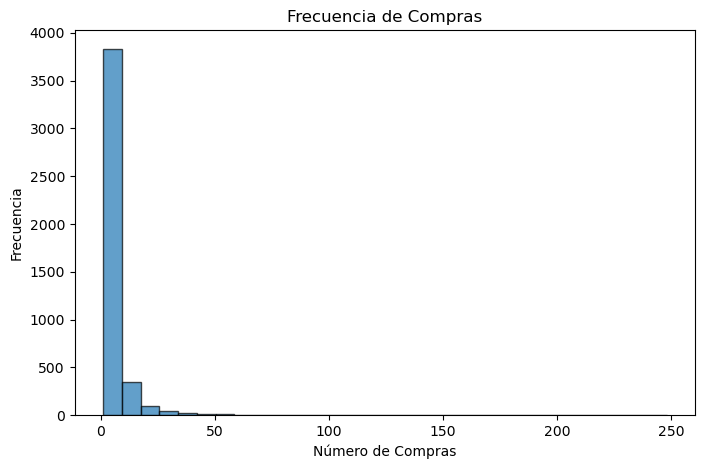

In [270]:
# Grafica un histograma de Frequency
plt.figure(figsize=(8,5))
plt.hist(customer['FREQUENCY'].dropna(), bins=30, edgecolor='black', alpha=0.7)
plt.title('Frecuencia de Compras')
plt.xlabel('Número de Compras')
plt.ylabel('Frecuencia')
plt.show()

In [272]:
# Imprime la Estadística de Resumen para Frequency
res_freq = customer['FREQUENCY'].describe()
res_freq

count    4372.000000
mean        5.075480
std         9.338754
min         1.000000
25%         1.000000
50%         3.000000
75%         5.000000
max       248.000000
Name: FREQUENCY, dtype: float64

## Monetary
<p>Valor del monto total que ha gastado un cliente en la compra de mis productos</p>

In [273]:
# Calcular el monto total por cada compra
df = cliente_segment
df['MONETARY'] =  df['QUANTITY'] * df['UNIT_PRICE']

# Obtener el valor monetario de compra por cliente
monetary = df.groupby('CUSTOMER_ID')['MONETARY'].sum().reset_index()
monetary.head()

,CUSTOMER_ID,MONETARY
0,12346.0,0.00
1,12347.0,4310.00
2,12348.0,1797.24
3,12349.0,1757.55
4,12350.0,334.40


In [274]:
# Unir el DataFrame que acabamos de crear con el de los clientes unicos
customer = pd.merge(customer, monetary, on='CUSTOMER_ID')
customer.head()

,CUSTOMER_ID,INVOICE_DATE,RECENCY,FREQUENCY,MONETARY
0,17850.0,2020-10-02 14:38:00,69.0,35,5288.63
1,13047.0,2020-10-24 14:02:00,47.0,18,3079.10
2,12583.0,2020-12-10 14:46:00,0.0,18,7187.34
3,13748.0,2020-07-04 10:13:00,159.0,5,948.25
4,15100.0,2020-10-01 10:35:00,70.0,6,635.10


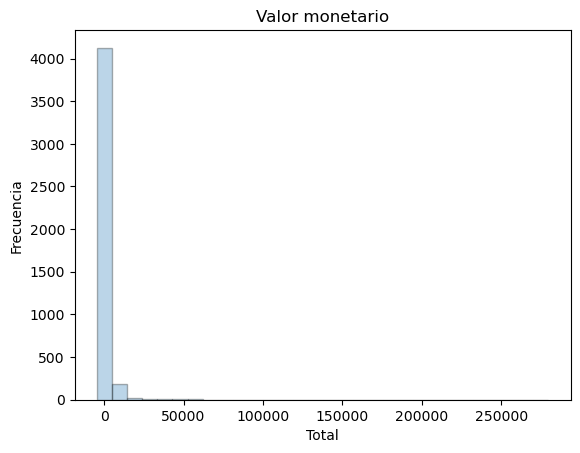

In [275]:
# Grafica un histograma de Monetary
plt.figure()
plt.hist(customer['MONETARY'], bins = 30, edgecolor = 'black', alpha = 0.3)
plt.title('Valor monetario')
plt.xlabel('Total')
plt.ylabel('Frecuencia')
plt.show()

In [276]:
# Imprime la Estadística de Resumen para Monetary

res_mon = customer['MONETARY'].describe()
res_mon

count      4372.000000
mean       1898.459701
std        8219.345141
min       -4287.630000
25%         293.362500
50%         648.075000
75%        1611.725000
max      279489.020000
Name: MONETARY, dtype: float64

## Algoritmo k-Means
<p>Ya creamos nuestros indicadores principales de la metodología RFM. es hora de hacer <i>Machine Learning</i>. Para ello utilizaremos un algoritmo no supervisado llamado <b>k-Means</b></p>
<p><img src="https://miro.medium.com/max/818/1*fG8u8nV7qR91wDyFDEEV-g.png" width="250"/></p>

In [165]:
# Funcion para ordenar los clusters
def order_cluster(cluster_field_name, target_field_name, df, ascending):
    new_cluster_field_name = 'new_' + cluster_field_name
    df_new = df.groupby(cluster_field_name)[target_field_name].mean().reset_index()
    df_new = df_new.sort_values(by=target_field_name,ascending=ascending).reset_index(drop=True)
    df_new['index'] = df_new.index
    df_final = pd.merge(df,df_new[[cluster_field_name,'index']], on=cluster_field_name)
    df_final = df_final.drop([cluster_field_name],axis=1)
    df_final = df_final.rename(columns={"index":cluster_field_name})
    return df_final

## Elbow Method
<p>¿Cual es mi número óptimo de clusters? Vamos a contruir una <i>gráfica de codo</i> para averiguarlo</p>

In [166]:
# Importa la librería de kMeans
from sklearn.cluster import KMeans

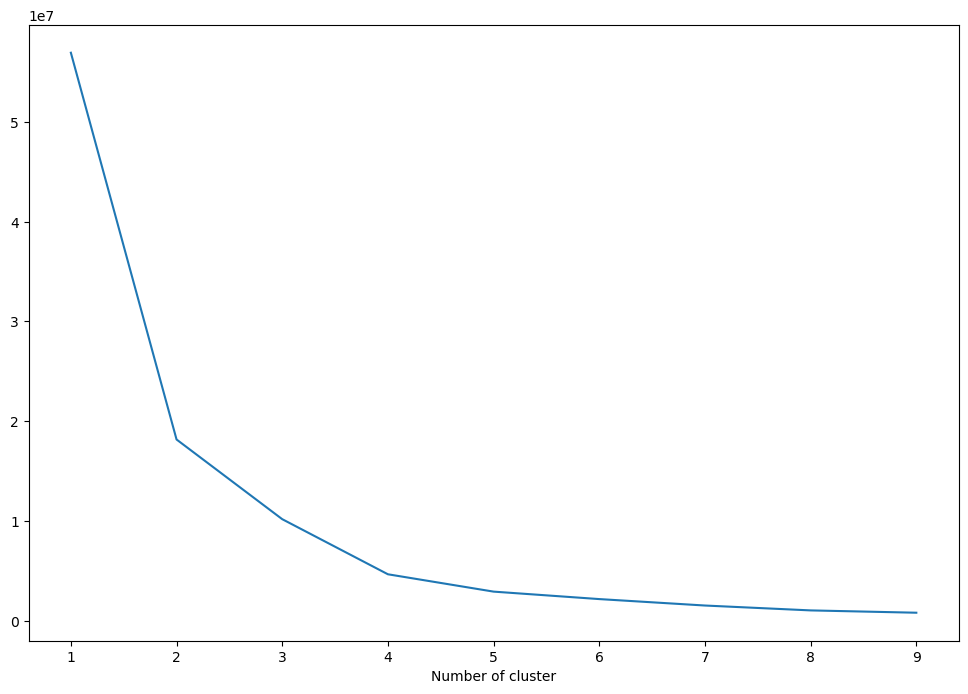

In [277]:
# Configuración inicial - Vamos a tomar como referencia el indicador de Recency
sse={}
recency = recency[['RECENCY']]

for k in range(1, 10):
    # Instancia el algoritmo de k-means iterando sobre k
    kmeans = KMeans(n_clusters = k, random_state = 42)
    
    # Entrena el algoritmo
    kmeans.fit(recency)
    
    # Adjunta las etiquetas
    recency["clusters"] = kmeans.labels_
    
    # Adunta la inercia o variación al arreglo sse
    sse[k] = kmeans.inertia_
    
# Grafico de codo (Elbow)
plt.figure(figsize=(12,8))
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

In [284]:
# Instanciar el algoritmo con 4 clusters para Recency 
kmeans = KMeans(n_clusters = 4, random_state = 42)

# Entrenar el algoritmo
kmeans.fit(customer[['RECENCY']])

# Obtener las predicciones
customer['RECENCY_CLUSTER'] = kmeans.labels_

# Ordenar los clusters
customer = order_cluster('RECENCY_CLUSTER', 'RECENCY', customer, False)

# Estadística Descriptiva del cluster creado
cluster_stats = customer.groupby('RECENCY_CLUSTER')['RECENCY'].describe()

In [285]:
cluster_stats

,count,mean,std,min,25%,50%,75%,max
RECENCY_CLUSTER,,,,,,,,
0,76.0,589.934211,94.109912,455.0,486.0,639.0,667.0,698.0
1,614.0,279.363192,44.867978,212.0,243.0,270.5,313.5,425.0
2,956.0,143.399582,35.224120,88.0,114.0,142.0,174.0,211.0
3,2726.0,32.363536,24.061944,0.0,12.0,25.0,51.0,87.0


In [289]:
# Instanciar el algoritmo con 4 clusters para Frequency 
kmeans = KMeans(n_clusters = 4, random_state= 42)

# Entrenar el algoritmo
kmeans.fit(customer[['FREQUENCY']])

# Obtener las predicciones
customer['FREQUENCY_CLUSTER'] = kmeans.labels_

# Ordenar los clusters
customer = order_cluster('FREQUENCY_CLUSTER', 'FREQUENCY', customer, True)

# Estadística Descriptiva de los clusters
cluster_stats = customer.groupby('FREQUENCY_CLUSTER')['FREQUENCY'].describe()
cluster_stats

,count,mean,std,min,25%,50%,75%,max
FREQUENCY_CLUSTER,,,,,,,,
0,3481.0,2.453605,1.546479,1.0,1.0,2.0,3.00,6.0
1,787.0,11.287166,4.275961,7.0,8.0,10.0,14.00,24.0
2,98.0,38.377551,14.750513,25.0,28.0,32.5,43.00,89.0
3,6.0,167.500000,56.807570,118.0,120.5,148.5,210.25,248.0


In [293]:
# Instanciar el algoritmo con 4 clusters para Monetary 
kmeans = KMeans(n_clusters = 4, random_state = 42)

# Entrenar el algoritmo
kmeans.fit(customer[['MONETARY']])

# Obtener las predicciones
customer['MONETARY_CLUSTER'] = kmeans.labels_

# Ordenar los clusters ¿Como tienes que ordenar el cluster?
customer = order_cluster('MONETARY_CLUSTER', 'MONETARY', customer, True)

# Estadística Descriptiva de los clusters
cluster_stats = customer.groupby('MONETARY_CLUSTER')['MONETARY'].describe()
cluster_stats

,count,mean,std,min,25%,50%,75%,max
MONETARY_CLUSTER,,,,,,,,
0,4329.0,1347.622983,1994.067733,-4287.63,291.0000,640.500,1550.8500,17588.26
1,36.0,35694.129167,14720.254051,18573.68,24695.2375,30800.450,50894.9825,65892.08
2,5.0,129057.952000,36658.292209,88125.38,113384.1400,123725.450,132572.6200,187482.17
3,2.0,267963.755000,16299.186073,256438.49,262201.1225,267963.755,273726.3875,279489.02


## Score de Segmentación
<p>El algoritmo de k-means nos da una segmentación generalizada, pero podemos personalizarla aún más creando una métrica que asigne una calificación al valor del cluster. Esto es lo que vamos a hacer!!</p>

In [299]:
# Vamos a crear nuestro score sumando el valor de cada uno de los clusters
customer['SCORE'] = customer['RECENCY_CLUSTER'] + customer['FREQUENCY_CLUSTER'] + customer['MONETARY_CLUSTER']

# Obtener el promedio para cada una de las métricas de las calificaciones creadas (Score)
score_stats = customer.groupby('SCORE').mean()[['RECENCY','FREQUENCY','MONETARY']]
score_stats

,RECENCY,FREQUENCY,MONETARY
SCORE,,,
0,589.934211,1.131579,217.693816
1,279.379085,1.441176,381.548889
2,145.143798,2.245884,658.829232
3,38.584759,3.085537,961.988442
4,24.634747,11.351573,3469.947127
5,10.837500,32.225000,11139.825375
6,12.409091,51.772727,36317.785455
7,5.500000,102.750000,87366.905000
8,4.666667,129.000000,222833.376667


In [319]:
# Crea una funcion que asigne lo siguiente: 
# Si score <= 1 entonces 'Low-Value', si score >1 y <=4 entonces 'Average', si score >4 y <=6 entonces 'Potential', por último si score >6 entonces 'High-Value'
def segment(score):
    if score <= 1:
        return 'Low-Value'
    elif score > 1 and score <= 4:
        return 'Average'
    elif score > 4 and score <= 6:
        return 'Potential'
    else:
        return 'High-Value'

# Crear una columna aplicando esta función al campo 'SCORE'
customer['SEGMENT'] = customer['SCORE'].apply(segment)

In [322]:
# Vamos a dar un vistazo a la tabla final
customer.head()

,CUSTOMER_ID,INVOICE_DATE,RECENCY,FREQUENCY,MONETARY,RECENCY_CLUSTER,FREQUENCY_CLUSTER,MONETARY_CLUSTER,SCORE,SEGMENT
0,17850.0,2020-10-02 14:38:00,69.0,35,5288.63,3,2,0,5,Potential
1,13468.0,2020-12-10 14:10:00,0.0,41,5656.75,3,2,0,5,Potential
2,17961.0,2020-12-09 11:44:00,1.0,39,1296.44,3,2,0,5,Potential
3,13599.0,2020-12-07 11:12:00,3.0,33,5030.60,3,2,0,5,Potential
4,15005.0,2020-11-24 12:25:00,16.0,35,6180.49,3,2,0,5,Potential


In [326]:
# Imprime la proporción o el total de clientes por segmento
proporcion_seg = customer['SEGMENT'].value_counts(normalize=True)
print(proporcion_seg)

Average       0.816789
Low-Value     0.157365
Potential     0.023330
High-Value    0.002516
Name: SEGMENT, dtype: float64


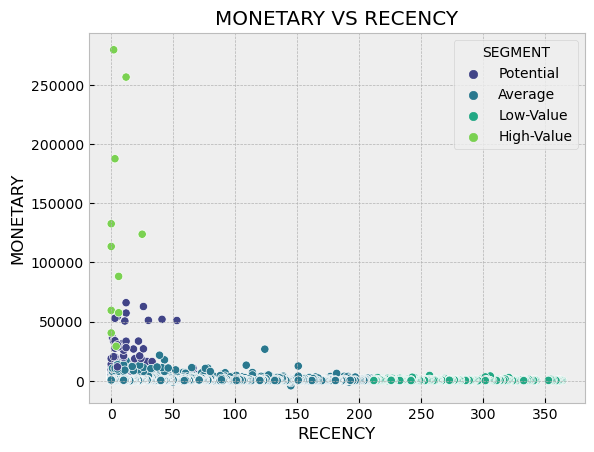

In [334]:
# Define un estilo 'bmh'
plt.style.use('bmh')

# Filtra los valores para RECENCY < 4000
filtro_rec = customer[customer['RECENCY'] < 400]

# Crea un grafico de dispersion de 'MONETARY' VS 'RECENCY' por Segmento

plt.figure()
sns.scatterplot(data = filtro_rec, x = 'RECENCY', y = 'MONETARY', hue = 'SEGMENT', palette = 'viridis')
plt.title('MONETARY VS RECENCY')
plt.xlabel('RECENCY')
plt.ylabel('MONETARY')
plt.show()

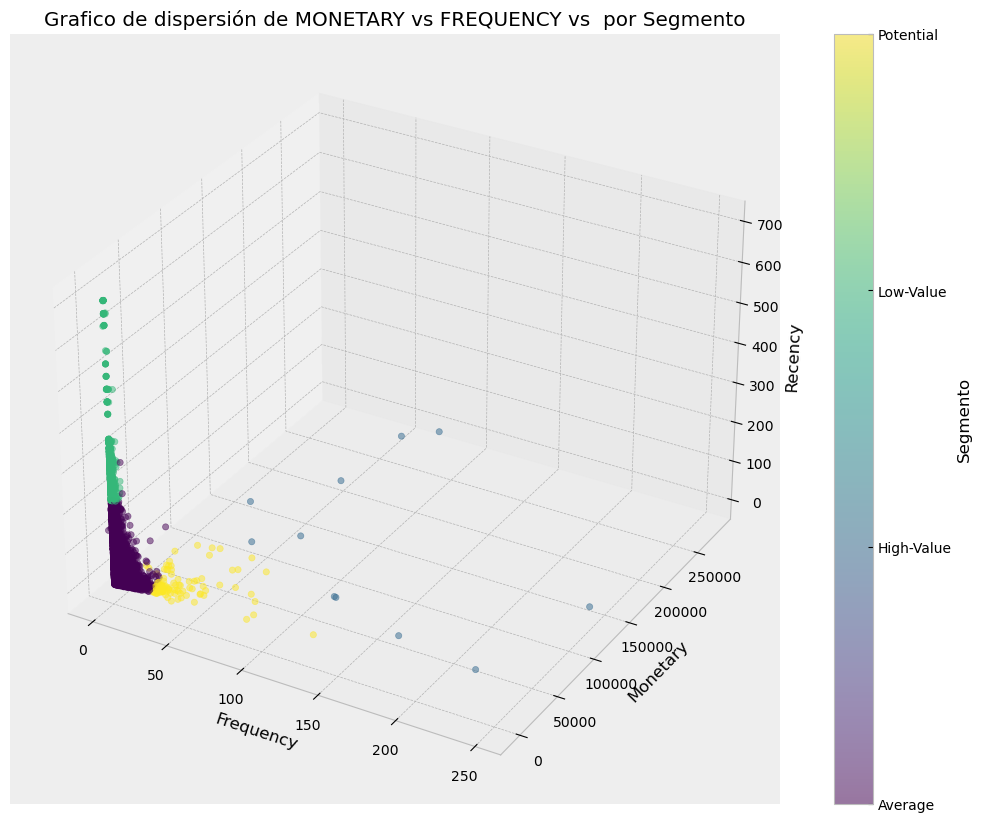

In [341]:
# Crea un grafico de dispersion de 'MONETARY' vs 'FREQUENCY' vs  por Segmento

from mpl_toolkits.mplot3d import Axes3D

filtered_data = customer[customer['RECENCY'] < 4000]

fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')

# Crear un gráfico de dispersión
scatter = ax.scatter(filtered_data['FREQUENCY'], filtered_data['MONETARY'], filtered_data['RECENCY'], 
                     c=filtered_data['SEGMENT'].astype('category').cat.codes, cmap='viridis', alpha=0.5)

# Añadir etiquetas y título
ax.set_xlabel('Frequency')
ax.set_ylabel('Monetary')
ax.set_zlabel('Recency')
ax.set_title('Grafico de dispersión de MONETARY vs FREQUENCY vs  por Segmento')

# Añadir una barra de colores
cbar = plt.colorbar(scatter)
cbar.set_label('Segmento')
cbar.set_ticks([0, 1, 2, 3])
cbar.set_ticklabels(filtered_data['SEGMENT'].astype('category').cat.categories)

# Mostrar el gráfico
plt.show()